<a href="https://colab.research.google.com/github/pscabral/IFMASOFTEX_1/blob/main/Yolo8_v1.6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install mega.py

from mega import Mega

# Crie uma instância da classe Mega
mega = Mega()

# Cole o link completo do Mega.nz (incluindo a chave)
url = "https://mega.nz/file/07dU2JqA#E0Y2NKwrYZm2uEPalkosVOqjteuuVjRvrfMSVcAajUg"

# Use o link completo para fazer o download
mega.download_url(url)

!unzip GrocerEyeYOLOv5v2.v1-2x-amount.yolov8.zip

In [ ]:
!pip install ultralytics

In [3]:
import os
import random
import pandas as pd
from PIL import Image
import cv2
from ultralytics import YOLO
from IPython.display import Video
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='darkgrid')
import pathlib
import glob
from tqdm.notebook import trange, tqdm
import warnings
warnings.filterwarnings('ignore')
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image

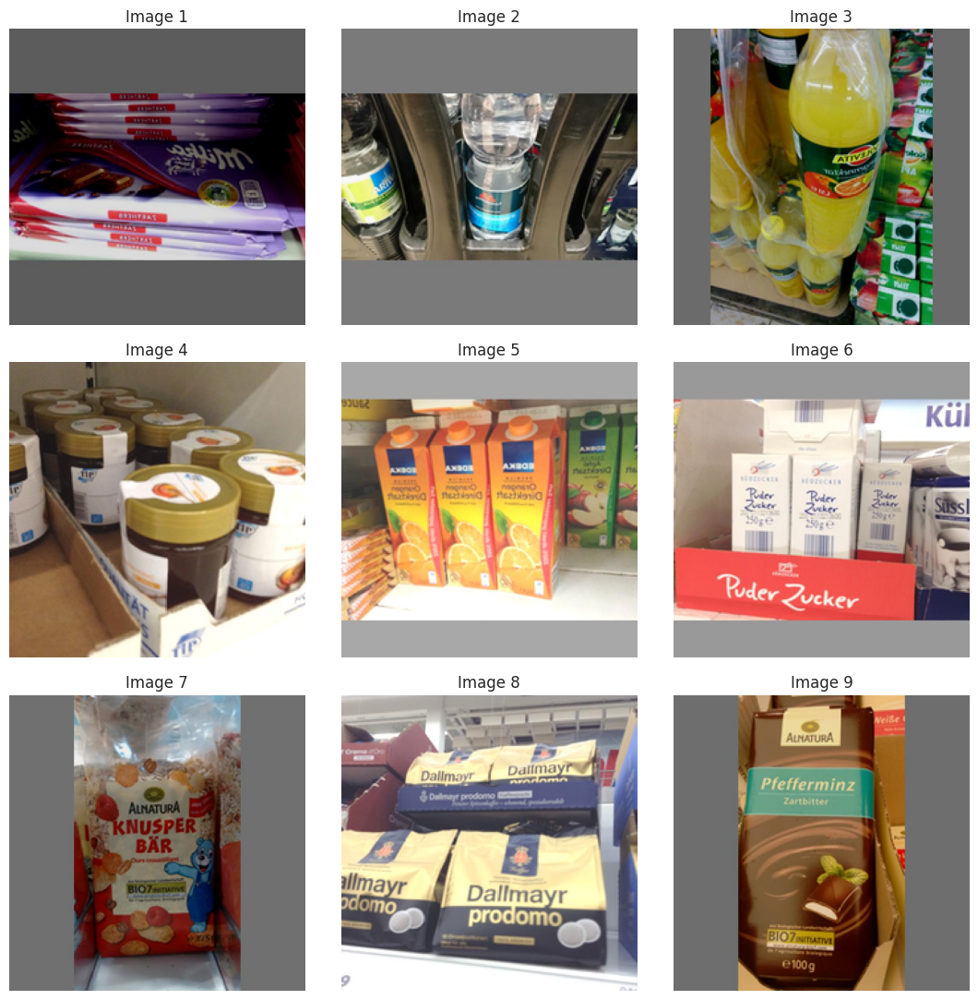

In [4]:
Image_dir = '/content/GrocerEyeYOLOv5v2.v1/train/images'

num_samples = 9
image_files = os.listdir(Image_dir)

# Randomly select num_samples images
rand_images = random.sample(image_files, num_samples)

fig, axes = plt.subplots(3, 3, figsize=(11, 11))

for i in range(num_samples):
    image = rand_images[i]
    ax = axes[i // 3, i % 3]
    ax.imshow(plt.imread(os.path.join(Image_dir, image)))
    ax.set_title(f'Image {i+1}')
    ax.axis('off')

plt.tight_layout()
plt.show()

In [5]:
image = cv2.imread("/content/GrocerEyeYOLOv5v2.v1/train/images/BEANS0000_png.rf.70a7651ec6853dc29b6e0e69b33d872c.jpg")
h, w, c = image.shape
print(f"The image has dimensions {w}x{h} and {c} channels.")

The image has dimensions 640x640 and 3 channels.


100%|██████████| 6.23M/6.23M [00:00<00:00, 24.9MB/s]



image 1/1 /content/GrocerEyeYOLOv5v2.v1/train/images/BEANS0000_png.rf.70a7651ec6853dc29b6e0e69b33d872c.jpg: 416x416 1 cup, 1 dining table, 228.8ms
Speed: 20.8ms preprocess, 228.8ms inference, 32.9ms postprocess per image at shape (1, 3, 416, 416)


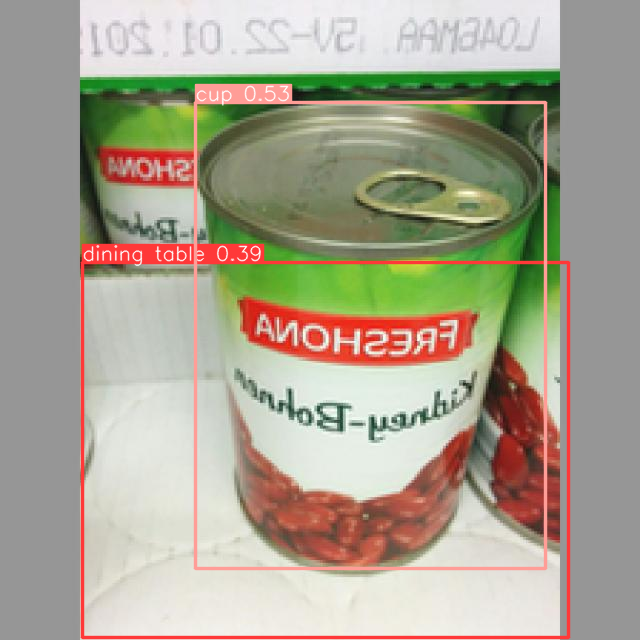

In [6]:
model = YOLO("yolov8n.pt")

# Use the model to detect object
image = "/content/GrocerEyeYOLOv5v2.v1/train/images/BEANS0000_png.rf.70a7651ec6853dc29b6e0e69b33d872c.jpg"
result_predict = model.predict(source = image, imgsz=(416))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [7]:
pip install -U albumentations

In [8]:
import albumentations as A
import cv2

# Declare an augmentation pipeline
transform = A.Compose([
    A.RandomCrop(width=256, height=256),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
])

# Read an image with OpenCV and convert it to the RGB colorspace
image = cv2.imread("/content/GrocerEyeYOLOv5v2.v1/train/images/BEANS0000_png.rf.70a7651ec6853dc29b6e0e69b33d872c.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Augment an image
transformed = transform(image=image)
transformed_image = transformed["image"]

In [9]:
Final_model = YOLO('yolov8n.pt')
Result_Final_model = Final_model.train(data="/content/GrocerEyeYOLOv5v2.v1/data.yaml", epochs=50, imgsz=416, batch=64, lr0=0.0001, dropout=0.15, device='cpu')


Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/GrocerEyeYOLOv5v2.v1/data.yaml, epochs=50, time=None, patience=50, batch=64, imgsz=416, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.15, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tru

100%|██████████| 755k/755k [00:00<00:00, 4.81MB/s]


Overriding model.yaml nc=80 with nc=18

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

train: Scanning /content/GrocerEyeYOLOv5v2.v1/train/labels... 5506 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5506/5506 [00:04<00:00, 1370.23it/s]


train: New cache created: /content/GrocerEyeYOLOv5v2.v1/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/GrocerEyeYOLOv5v2.v1/valid/labels... 789 images, 0 backgrounds, 0 corrupt: 100%|██████████| 789/789 [00:00<00:00, 1380.82it/s]

val: New cache created: /content/GrocerEyeYOLOv5v2.v1/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000455, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G       1.01      3.656      1.267         12        416: 100%|██████████| 87/87 [10:11<00:00,  7.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.25s/it]

                   all        789       1903      0.279      0.225      0.157      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50         0G     0.9255      2.597      1.216          6        416: 100%|██████████| 87/87 [10:14<00:00,  7.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.06s/it]

                   all        789       1903      0.329      0.438       0.34      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50         0G     0.8973      2.085      1.189          7        416: 100%|██████████| 87/87 [10:22<00:00,  7.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.29s/it]

                   all        789       1903        0.4      0.427      0.351      0.232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50         0G     0.8761      1.791      1.157          8        416: 100%|██████████| 87/87 [10:24<00:00,  7.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.21s/it]

                   all        789       1903      0.484       0.54      0.504      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50         0G      0.856      1.615      1.133          5        416: 100%|██████████| 87/87 [10:27<00:00,  7.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.16s/it]

                   all        789       1903      0.571      0.503      0.531      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50         0G      0.832      1.463      1.108         13        416: 100%|██████████| 87/87 [10:22<00:00,  7.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.35s/it]

                   all        789       1903      0.634      0.588      0.618      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50         0G     0.8134      1.376      1.096          9        416: 100%|██████████| 87/87 [10:17<00:00,  7.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.11s/it]

                   all        789       1903      0.712      0.662      0.733      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50         0G      0.802      1.289       1.09         10        416: 100%|██████████| 87/87 [10:33<00:00,  7.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.23s/it]

                   all        789       1903      0.647      0.631      0.664      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50         0G     0.7864      1.224      1.076         13        416: 100%|██████████| 87/87 [10:23<00:00,  7.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.27s/it]

                   all        789       1903      0.718      0.654      0.706       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50         0G     0.7728       1.17      1.069         12        416: 100%|██████████| 87/87 [10:27<00:00,  7.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.15s/it]

                   all        789       1903      0.745      0.599      0.697      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50         0G     0.7717      1.111      1.067          6        416: 100%|██████████| 87/87 [10:22<00:00,  7.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.19s/it]

                   all        789       1903      0.724      0.681      0.763      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50         0G     0.7551      1.061      1.052         15        416: 100%|██████████| 87/87 [10:16<00:00,  7.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.25s/it]

                   all        789       1903      0.732      0.689      0.779      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50         0G      0.748      1.051       1.05         12        416: 100%|██████████| 87/87 [10:26<00:00,  7.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.27s/it]

                   all        789       1903      0.731      0.706      0.781      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50         0G     0.7332     0.9989      1.043          8        416: 100%|██████████| 87/87 [10:36<00:00,  7.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.11s/it]

                   all        789       1903      0.779      0.708      0.801       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50         0G     0.7303     0.9767      1.037          8        416: 100%|██████████| 87/87 [10:34<00:00,  7.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.14s/it]

                   all        789       1903      0.787      0.739      0.822      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50         0G     0.7215     0.9187      1.033         13        416: 100%|██████████| 87/87 [10:31<00:00,  7.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.39s/it]

                   all        789       1903      0.815      0.722      0.831      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50         0G       0.72     0.9032      1.034         12        416: 100%|██████████| 87/87 [10:36<00:00,  7.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.29s/it]

                   all        789       1903      0.792      0.742      0.828      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50         0G     0.7123     0.8707      1.025         13        416: 100%|██████████| 87/87 [10:24<00:00,  7.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.11s/it]

                   all        789       1903      0.827       0.75      0.849      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50         0G     0.6956     0.8411      1.015          9        416: 100%|██████████| 87/87 [10:25<00:00,  7.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.92s/it]

                   all        789       1903      0.849      0.778      0.878      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50         0G      0.697     0.8269       1.02          7        416: 100%|██████████| 87/87 [10:19<00:00,  7.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.05s/it]

                   all        789       1903      0.836      0.757       0.86      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50         0G     0.6904     0.8053      1.017          6        416: 100%|██████████| 87/87 [10:31<00:00,  7.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.19s/it]

                   all        789       1903      0.825      0.786      0.868      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50         0G     0.6898      0.807      1.014         11        416: 100%|██████████| 87/87 [10:27<00:00,  7.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.27s/it]

                   all        789       1903      0.846      0.784      0.872       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50         0G     0.6732      0.768      1.009          8        416: 100%|██████████| 87/87 [10:27<00:00,  7.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.01s/it]

                   all        789       1903      0.829      0.784      0.874      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50         0G     0.6791     0.7747      1.013          6        416: 100%|██████████| 87/87 [10:16<00:00,  7.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.11s/it]

                   all        789       1903      0.821      0.813      0.891      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50         0G     0.6667     0.7543      1.004         12        416: 100%|██████████| 87/87 [10:19<00:00,  7.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.09s/it]

                   all        789       1903      0.841      0.778      0.869      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50         0G     0.6685     0.7283      1.008          5        416: 100%|██████████| 87/87 [10:15<00:00,  7.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.90s/it]

                   all        789       1903      0.831      0.829      0.891      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50         0G     0.6651     0.7186      1.003          6        416: 100%|██████████| 87/87 [10:16<00:00,  7.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.08s/it]

                   all        789       1903       0.86      0.792      0.895      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50         0G      0.654     0.7073     0.9966         13        416: 100%|██████████| 87/87 [10:09<00:00,  7.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.89s/it]

                   all        789       1903      0.853      0.802      0.884      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50         0G     0.6479     0.6911      0.993         10        416: 100%|██████████| 87/87 [10:12<00:00,  7.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.91s/it]

                   all        789       1903      0.868      0.833      0.906       0.75



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50         0G     0.6443     0.6814     0.9933         11        416: 100%|██████████| 87/87 [10:20<00:00,  7.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.94s/it]

                   all        789       1903      0.879      0.815      0.902      0.747



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50         0G     0.6394     0.6708     0.9913          4        416: 100%|██████████| 87/87 [10:20<00:00,  7.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.07s/it]

                   all        789       1903      0.886      0.813      0.908      0.758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50         0G     0.6362     0.6543     0.9831         15        416: 100%|██████████| 87/87 [10:26<00:00,  7.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.26s/it]

                   all        789       1903      0.885      0.837       0.91      0.749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50         0G      0.632     0.6467     0.9861         12        416: 100%|██████████| 87/87 [10:39<00:00,  7.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.18s/it]

                   all        789       1903      0.902        0.8      0.909      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50         0G       0.63     0.6345     0.9847         14        416: 100%|██████████| 87/87 [10:23<00:00,  7.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.30s/it]

                   all        789       1903      0.866      0.809      0.894      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50         0G     0.6272     0.6358     0.9886         11        416: 100%|██████████| 87/87 [10:22<00:00,  7.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.19s/it]

                   all        789       1903      0.855      0.839       0.91      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50         0G     0.6172     0.6372     0.9792         10        416: 100%|██████████| 87/87 [10:25<00:00,  7.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.90s/it]

                   all        789       1903      0.855      0.843      0.908      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50         0G     0.6186     0.6157     0.9807          4        416: 100%|██████████| 87/87 [10:21<00:00,  7.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.06s/it]

                   all        789       1903      0.884      0.849      0.919       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50         0G     0.6158     0.6066     0.9795         10        416: 100%|██████████| 87/87 [10:29<00:00,  7.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.09s/it]

                   all        789       1903      0.872      0.838      0.911      0.768



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50         0G      0.613     0.6073     0.9774          9        416: 100%|██████████| 87/87 [10:18<00:00,  7.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.98s/it]

                   all        789       1903      0.864      0.848      0.914      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50         0G     0.6049     0.5889     0.9723         11        416: 100%|██████████| 87/87 [10:19<00:00,  7.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.06s/it]

                   all        789       1903      0.884      0.834      0.916      0.769


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50         0G     0.5088     0.4136     0.9091          2        416: 100%|██████████| 87/87 [10:18<00:00,  7.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.96s/it]

                   all        789       1903      0.896      0.818      0.912      0.761



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50         0G     0.4968     0.3789     0.9055          4        416: 100%|██████████| 87/87 [10:12<00:00,  7.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.07s/it]

                   all        789       1903      0.863       0.85      0.913      0.766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50         0G     0.5009     0.3694     0.9047          4        416: 100%|██████████| 87/87 [10:18<00:00,  7.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:36<00:00,  5.15s/it]

                   all        789       1903      0.879      0.827       0.91      0.765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50         0G     0.4846     0.3854     0.9019          4        416: 100%|██████████| 87/87 [10:13<00:00,  7.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.99s/it]

                   all        789       1903       0.87      0.844      0.909      0.758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50         0G     0.4785     0.3465     0.8931          7        416: 100%|██████████| 87/87 [10:16<00:00,  7.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.02s/it]

                   all        789       1903      0.894      0.832      0.914      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50         0G     0.4704     0.3613     0.8945          6        416: 100%|██████████| 87/87 [10:06<00:00,  6.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.02s/it]

                   all        789       1903      0.876      0.843      0.913      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50         0G     0.4598     0.3468     0.8894          4        416: 100%|██████████| 87/87 [10:08<00:00,  6.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.99s/it]

                   all        789       1903      0.889      0.842      0.914      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50         0G     0.4558     0.3327      0.888          5        416: 100%|██████████| 87/87 [10:31<00:00,  7.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:37<00:00,  5.32s/it]

                   all        789       1903       0.89      0.847      0.914      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50         0G     0.4503     0.3211     0.8834          4        416: 100%|██████████| 87/87 [10:21<00:00,  7.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:34<00:00,  4.98s/it]

                   all        789       1903      0.886      0.844      0.914      0.766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50         0G     0.4508     0.3192     0.8868          3        416: 100%|██████████| 87/87 [10:13<00:00,  7.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:35<00:00,  5.12s/it]

                   all        789       1903      0.897      0.844      0.917      0.771



50 epochs completed in 9.144 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 3009158 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:33<00:00,  4.72s/it]


                   all        789       1903      0.882      0.851      0.919       0.77
                 beans        789         63       0.94      0.952      0.986      0.854
                 candy        789        130       0.86      0.757      0.849      0.636
                cereal        789        109      0.916      0.798      0.914      0.756
                 chips        789         41      0.827      0.927      0.951      0.799
             chocolate        789        113      0.762      0.821       0.87      0.695
                coffee        789        169      0.922      0.716      0.849      0.723
                  fish        789         88      0.837      0.864      0.929      0.749
                 honey        789         56      0.922      0.848      0.945        0.8
                   jam        789        202      0.888      0.906       0.96      0.854
                 juice        789        191      0.858      0.917      0.959       0.86
                  mil

In [10]:
print('result of training')
tpaths2=[]
for dirname, _, filenames in os.walk('/content/runs/detect/train'):
    for filename in filenames:
        if filename[-4:]=='.png' or filename[-4:]=='.jpg':
            tpaths2+=[(os.path.join(dirname, filename))]
tpaths2=sorted(tpaths2)
print(tpaths2[0])

result of training
/content/runs/detect/train/F1_curve.png


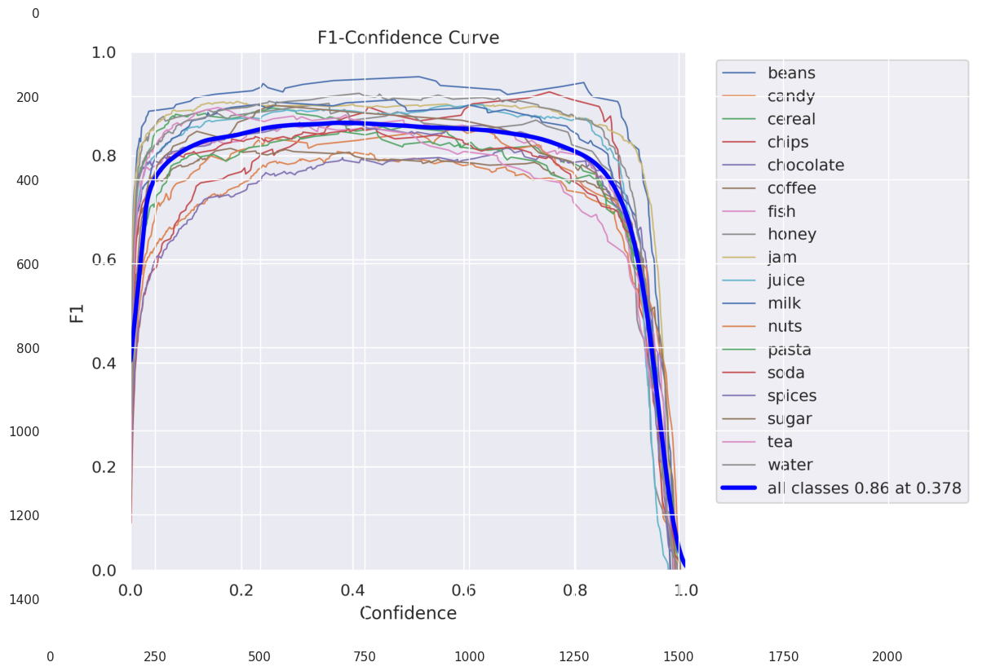

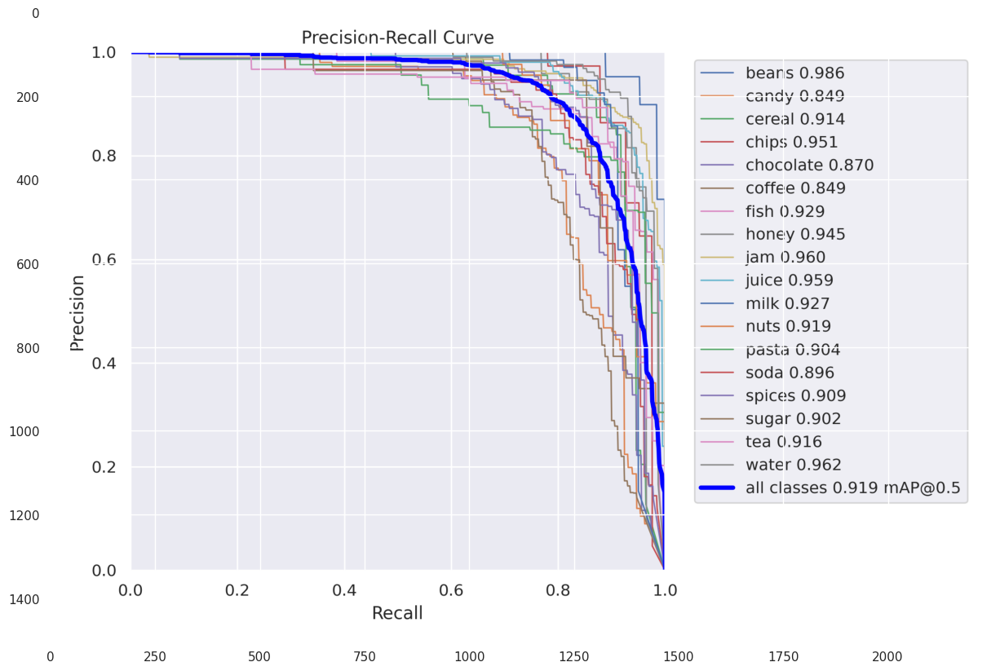

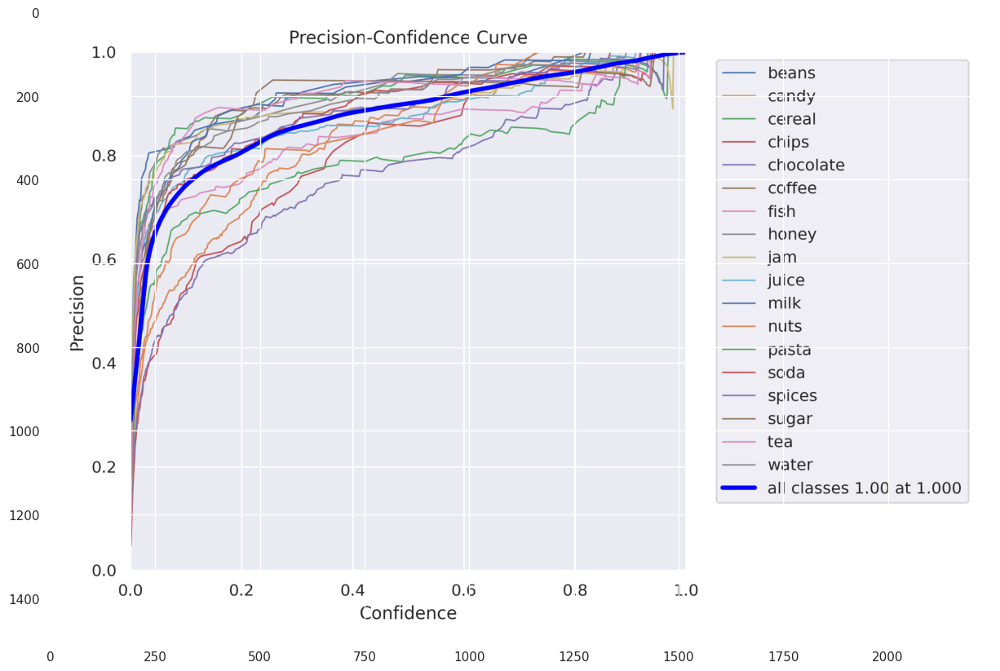

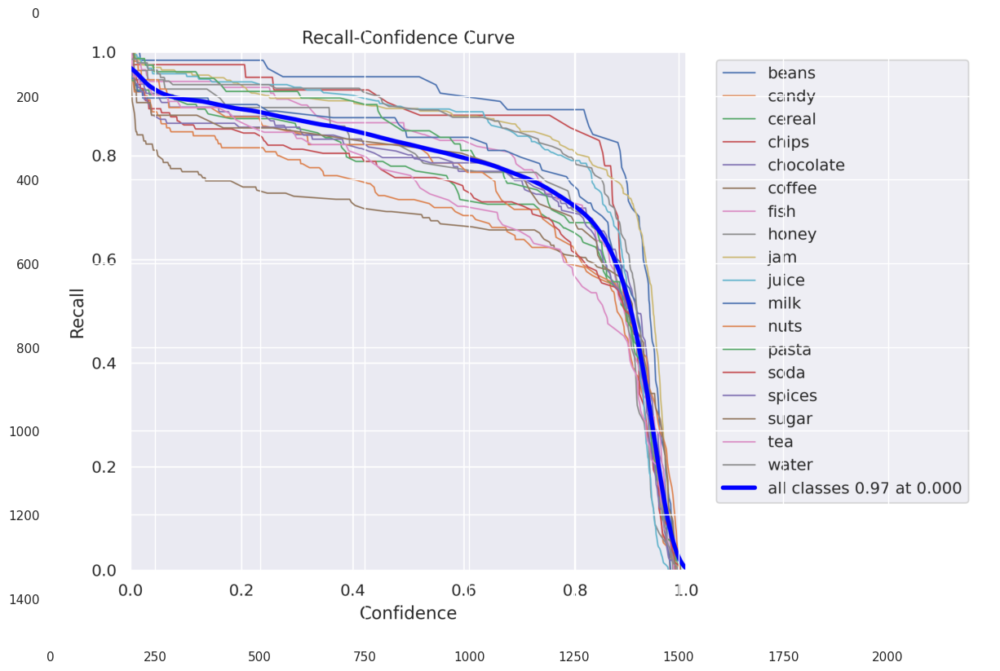

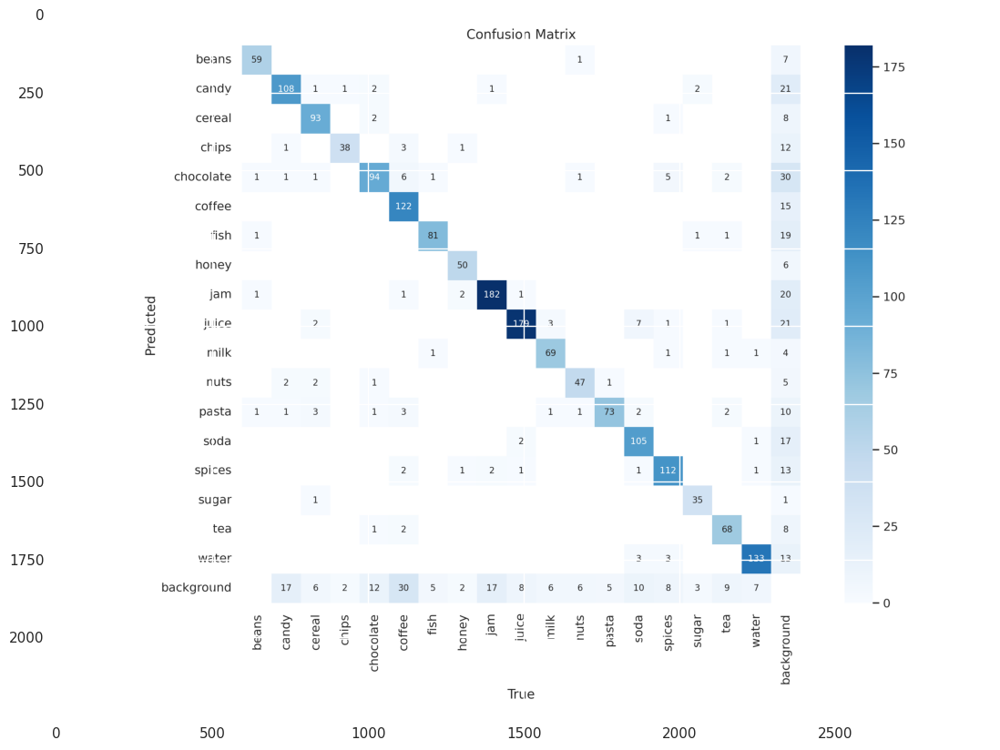

...

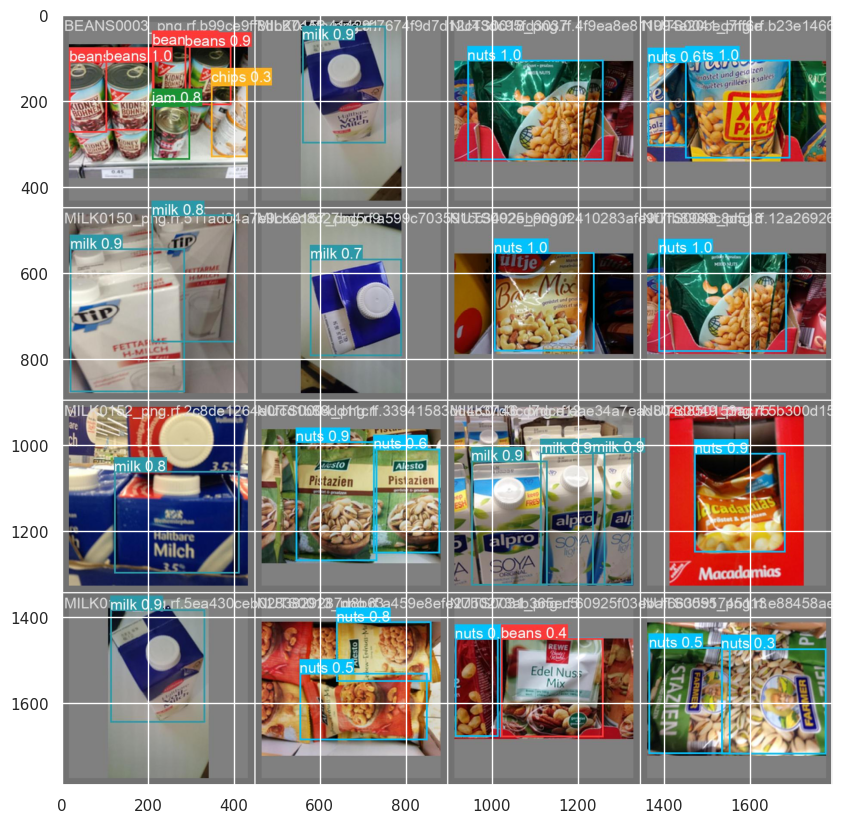

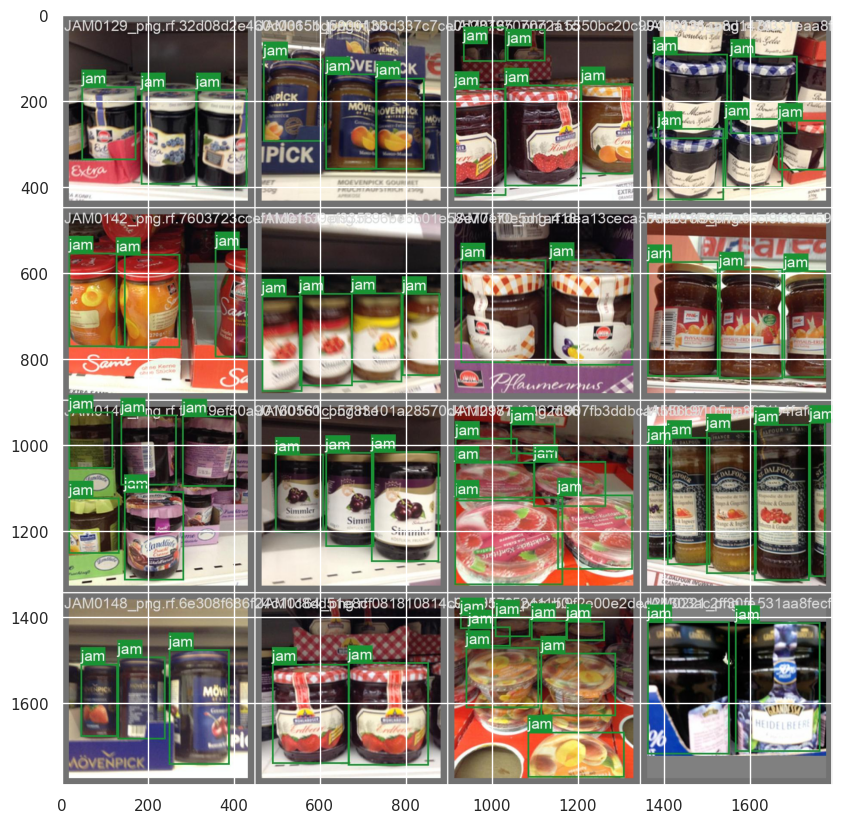

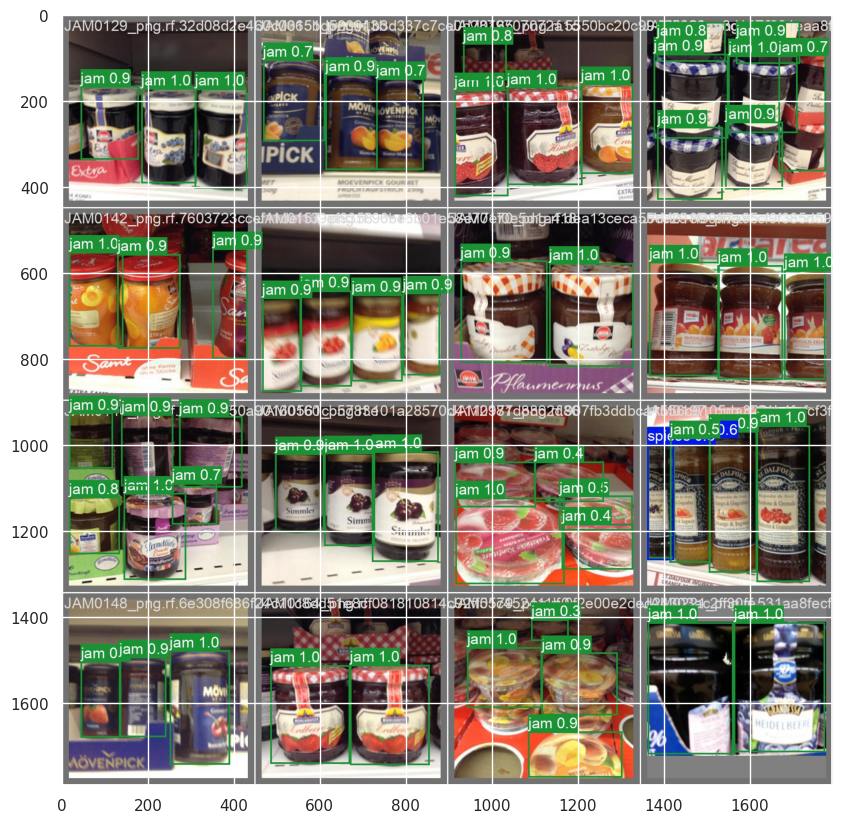

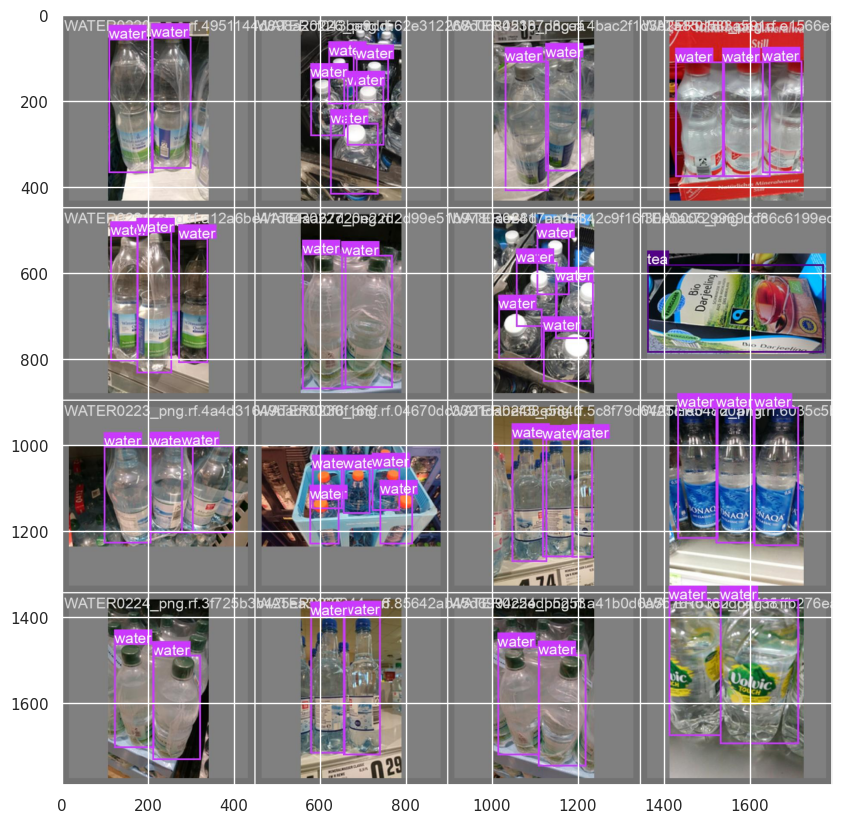

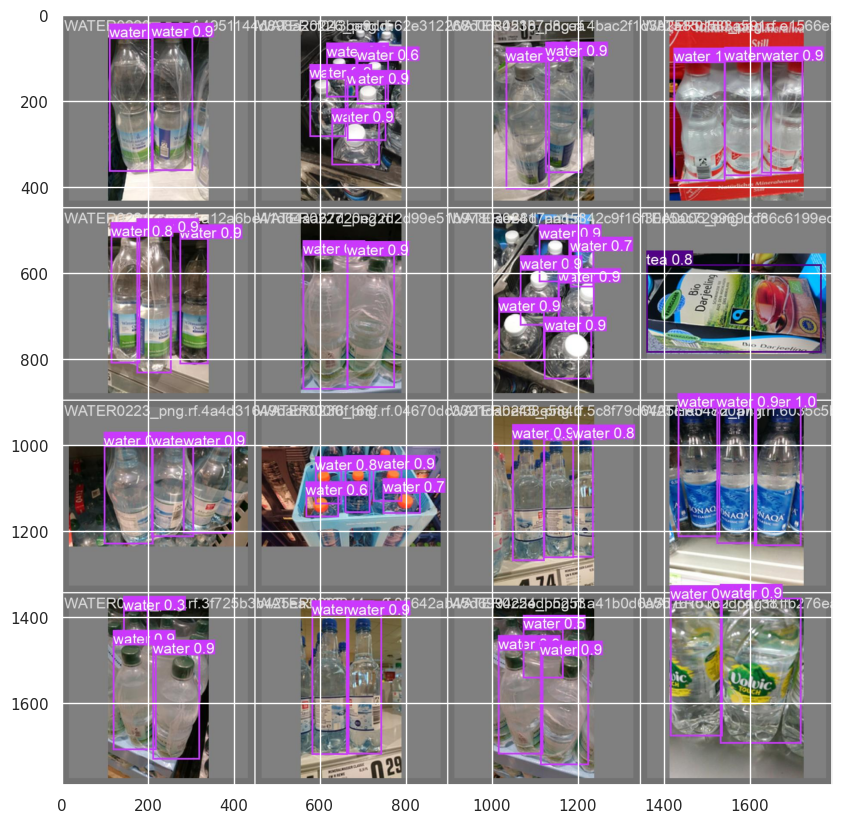

In [11]:
for path in tpaths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

In [12]:
print('Predict')
best_path0='runs/detect/train/weights/best.pt'
source0='/content/GrocerEyeYOLOv5v2.v1/test/images'

Predict


In [13]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths)
print(ppaths[0])

/content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0005_png.rf.7a3b05005d9993f1288f5551f39fa9c8.jpg


In [14]:
model2 = YOLO(best_path0)
print('yolo task=detect mode=predict')

yolo task=detect mode=predict


In [15]:
!yolo task=detect mode=predict model={best_path0} conf=0.4 source={source0}

Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 3009158 parameters, 0 gradients, 8.1 GFLOPs

image 1/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0005_png.rf.7a3b05005d9993f1288f5551f39fa9c8.jpg: 416x416 1 beans, 82.6ms
image 2/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0010_png.rf.bb5f5baf68252fc4bbe60a28c99f32ca.jpg: 416x416 5 nutss, 46.7ms
image 3/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0016_png.rf.1aece0bf0d8b5877ac03def4f469f10e.jpg: 416x416 3 beanss, 42.6ms
image 4/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0023_png.rf.d76e40f233b169717ceca22cf1799e6e.jpg: 416x416 3 beanss, 47.1ms
image 5/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0034_png.rf.33c95beacddce63373b356a6ffab7b90.jpg: 416x416 2 beanss, 60.2ms
image 6/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0043_png.rf.b12740e09f7b859d2f32afa3329f576b.jpg: 416x416 2 beanss, 60.0ms
image 7/393 /content/GrocerEyeYOL

In [16]:
print('Result of Prediction')
results = model2.predict(source0,conf=0.4)
print(len(results))

Result of Prediction

image 1/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0005_png.rf.7a3b05005d9993f1288f5551f39fa9c8.jpg: 416x416 1 beans, 67.9ms
image 2/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0010_png.rf.bb5f5baf68252fc4bbe60a28c99f32ca.jpg: 416x416 5 nutss, 68.2ms
image 3/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0016_png.rf.1aece0bf0d8b5877ac03def4f469f10e.jpg: 416x416 3 beanss, 41.5ms
image 4/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0023_png.rf.d76e40f233b169717ceca22cf1799e6e.jpg: 416x416 3 beanss, 46.9ms
image 5/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0034_png.rf.33c95beacddce63373b356a6ffab7b90.jpg: 416x416 2 beanss, 42.3ms
image 6/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0043_png.rf.b12740e09f7b859d2f32afa3329f576b.jpg: 416x416 2 beanss, 42.0ms
image 7/393 /content/GrocerEyeYOLOv5v2.v1/test/images/BEANS0048_png.rf.d6295b7e2ef8fa2cce2f95994f041d02.jpg: 416x416 3 beanss, 44.1ms
image 8/393 /content/GrocerEyeYOLOv5v2.v1/

In [17]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

,x,y,x2,y2,confidence,class,file,i
0,201.393341,138.882538,436.193542,497.725189,0.869050,0.0,BEANS0005_png.rf.7a3b05005d9993f1288f5551f39fa...,0.0
0,446.082550,97.677475,595.852966,349.541595,0.897208,11.0,BEANS0010_png.rf.bb5f5baf68252fc4bbe60a28c99f3...,1.0
1,105.037903,78.652245,294.630737,367.711182,0.859622,11.0,BEANS0010_png.rf.bb5f5baf68252fc4bbe60a28c99f3...,1.0
2,441.838013,346.799377,586.778137,556.710205,0.843385,11.0,BEANS0010_png.rf.bb5f5baf68252fc4bbe60a28c99f3...,1.0
3,292.548279,80.557632,456.412750,356.780212,0.770928,11.0,BEANS0010_png.rf.bb5f5baf68252fc4bbe60a28c99f3...,1.0
...,...,...,...,...,...,...,...,...
4,306.697357,139.858231,421.679230,495.083862,0.927579,17.0,WATER0225_png.rf.8b9c5471bb14015f930c93852fcfd...,390.0
5,0.000000,141.206818,58.852833,495.810486,0.730003,17.0,WATER0225_png.rf.8b9c5471bb14015f930c93852fcfd...,390.0
0,312.154541,181.502747,467.819031,559.891724,0.953817,17.0,WATER0237_png.rf.53c12a5305491378ccff19aa93b9d...,391.0
1,163.201706,191.718246,321.731903,571.590393,0.905511,17.0,WATER0237_png.rf.53c12a5305491378ccff19aa93b9d...,391.0


In [18]:
class_map = {
    0: 'beans',
    1: 'candy',
    2: 'cereal',
    3: 'chips',
    4: 'chocolate',
    5: 'coffee',
    6: 'fish',
    7: 'honey',
    8: 'jam',
    9: 'juice',
    10: 'milk',
    11: 'nuts',
    12: 'pasta',
    13: 'soda',
    14: 'spices',
    15: 'sugar',
    16: 'tea',
    17: 'water'
}

In [19]:
PBOX['class'] = PBOX['class'].apply(lambda x: class_map[int(x)])
PBOX = PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

,x,y,x2,y2,confidence,class,file,i
0,201.393341,138.882538,436.193542,497.725189,0.869050,beans,BEANS0005_png.rf.7a3b05005d9993f1288f5551f39fa...,0.0
1,446.082550,97.677475,595.852966,349.541595,0.897208,nuts,BEANS0010_png.rf.bb5f5baf68252fc4bbe60a28c99f3...,1.0
2,105.037903,78.652245,294.630737,367.711182,0.859622,nuts,BEANS0010_png.rf.bb5f5baf68252fc4bbe60a28c99f3...,1.0
3,441.838013,346.799377,586.778137,556.710205,0.843385,nuts,BEANS0010_png.rf.bb5f5baf68252fc4bbe60a28c99f3...,1.0
4,292.548279,80.557632,456.412750,356.780212,0.770928,nuts,BEANS0010_png.rf.bb5f5baf68252fc4bbe60a28c99f3...,1.0
...,...,...,...,...,...,...,...,...
948,306.697357,139.858231,421.679230,495.083862,0.927579,water,WATER0225_png.rf.8b9c5471bb14015f930c93852fcfd...,390.0
949,0.000000,141.206818,58.852833,495.810486,0.730003,water,WATER0225_png.rf.8b9c5471bb14015f930c93852fcfd...,390.0
950,312.154541,181.502747,467.819031,559.891724,0.953817,water,WATER0237_png.rf.53c12a5305491378ccff19aa93b9d...,391.0
951,163.201706,191.718246,321.731903,571.590393,0.905511,water,WATER0237_png.rf.53c12a5305491378ccff19aa93b9d...,391.0


candy        95
water        88
juice        80
jam          73
chocolate    71
spices       56
cereal       53
pasta        51
tea          50
chips        48
coffee       45
honey        44
soda         43
fish         35
milk         33
nuts         31
sugar        31
beans        26
Name: class, dtype: int64

In [20]:
def draw_box2(n0):

    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath.split('/')[-1]

    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.loc[i,'class']
            x=int(box.loc[i,'x'])
            y=int(box.loc[i,'y'])
            x2=int(box.loc[i,'x2'])
            y2=int(box.loc[i,'y2'])
            #print(label,x,y,x2,y2)
            cv2.putText(image, f'{label}', (x, int(y-4)),
                        cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,0),2)
            cv2.rectangle(image,(x,y),(x2,y2),(0,255,0),2) #green

    #plt.imshow(image)
    #plt.show()

    return image

In [21]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {20+i}')
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000)

In [22]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

  0%|          | 0/393 [00:00<?, ?it/s]

In [23]:
create_animation(images2)